In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from pathlib import Path

import torch
import torch.nn.functional as F
import torchvision
from torch import nn
from torch.utils.data import Dataset, DataLoader


import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import json
import math
import random
import numpy as np
import scipy as sp
import scipy.stats as st
import scipy.integrate as integrate
from scipy.stats import multivariate_normal
from sklearn import linear_model
from sklearn.exceptions import ConvergenceWarning
import statsmodels.api as sm
from matplotlib.colors import LogNorm
import pickle

from joblib import Parallel, delayed
import multiprocessing
from collections import namedtuple
from itertools import count

import cProfile
from datetime import datetime

sns.set_style("whitegrid")
sns.set_palette("colorblind")
palette = sns.color_palette()
figsize = (15,8)
legend_fontsize = 16

from matplotlib import rc
rc('font',**{'family':'sans-serif'})
rc('text', usetex=True)
rc('text.latex',preamble=r'\usepackage[utf8]{inputenc}')
rc('text.latex',preamble=r'\usepackage[russian]{babel}')
rc('figure', **{'dpi': 300})

In [2]:
device = "cuda:0"

In [3]:
transform = torchvision.transforms.Compose(
    [
       torchvision.transforms.ToTensor(),
       torchvision.transforms.Normalize(
           (0.5, 0.5, 0.5), 
           (0.5, 0.5, 0.5)
       ),
    ]
)

inverse_transform = torchvision.transforms.Compose(
    [
       torchvision.transforms.Normalize(
           (-1, -1, -1), 
           (2, 2, 2)
       ),
       torchvision.transforms.ToPILImage()
    ]
)

# 1. Pix2Pix

In [4]:
class FacadeDataset(Dataset):

    def __init__(self, path, transforms):
        super().__init__()
        self.image_pathes = list(Path(path).rglob("*.jpg"))
        self.transforms = transforms

    def __len__(self):
        return len(self.image_pathes)

    def __getitem__(self, idx):
        path = self.image_pathes[idx]
        image = Image.open(path)
        width = image.width
        sep = width // 2
        image_array = np.array(image)
        input_image = image_array[:, sep:]
        output_image = image_array[:, :sep]
        input_image = self.transforms(input_image)
        output_image = self.transforms(output_image)
        return input_image, output_image

In [5]:
class GeneratorUNet(nn.Module):

    def __init__(self, in_channels=3, out_channels=3, init_features=32):
        super().__init__()

        features = init_features
        self.encoder1 = self._block(in_channels, features)
        self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.encoder2 = self._block(features, features * 2)
        self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.encoder3 = self._block(features * 2, features * 4)
        self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.encoder4 = self._block(features * 4, features * 8)
        self.pool4 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.bottleneck = self._block(features * 8, features * 16)

        self.upconv4 = nn.ConvTranspose2d(
            features * 16, features * 8, kernel_size=2, stride=2
        )
        self.decoder4 = self._block((features * 8) * 2, features * 8)
        self.upconv3 = nn.ConvTranspose2d(
            features * 8, features * 4, kernel_size=2, stride=2
        )
        self.decoder3 = self._block((features * 4) * 2, features * 4)
        self.upconv2 = nn.ConvTranspose2d(
            features * 4, features * 2, kernel_size=2, stride=2
        )
        self.decoder2 = self._block((features * 2) * 2, features * 2)
        self.upconv1 = nn.ConvTranspose2d(
            features * 2, features, kernel_size=2, stride=2
        )
        self.decoder1 = self._block(features * 2, features)

        self.conv = nn.Conv2d(
            in_channels=features, out_channels=out_channels, kernel_size=1
        )

    def forward(self, x):
        enc1 = self.encoder1(x)
        enc2 = self.encoder2(self.pool1(enc1))
        enc3 = self.encoder3(self.pool2(enc2))
        enc4 = self.encoder4(self.pool3(enc3))

        bottleneck = self.bottleneck(self.pool4(enc4))

        dec4 = self.upconv4(bottleneck)
        dec4 = torch.cat((dec4, enc4), dim=1)
        dec4 = self.decoder4(dec4)
        dec3 = self.upconv3(dec4)
        dec3 = torch.cat((dec3, enc3), dim=1)
        dec3 = self.decoder3(dec3)
        dec2 = self.upconv2(dec3)
        dec2 = torch.cat((dec2, enc2), dim=1)
        dec2 = self.decoder2(dec2)
        dec1 = self.upconv1(dec2)
        dec1 = torch.cat((dec1, enc1), dim=1)
        dec1 = self.decoder1(dec1)
        return torch.tanh(self.conv(dec1))

    @staticmethod
    def _block(in_channels, features):
        return nn.Sequential(
            nn.Conv2d(
                in_channels=in_channels,
                out_channels=features,
                kernel_size=3,
                padding=1,
                bias=False,
            ),
            nn.InstanceNorm2d(num_features=features),
            nn.ReLU(inplace=True),
            nn.Conv2d(
                in_channels=features,
                out_channels=features,
                kernel_size=3,
                padding=1,
                bias=False,
            ),
            nn.InstanceNorm2d(num_features=features),
            nn.ReLU(inplace=True),
        )

In [6]:
generator = GeneratorUNet(3)
backbone = torchvision.models.resnet18(pretrained=False, num_classes=1, norm_layer=nn.InstanceNorm2d)

In [7]:
backbone.conv1 = nn.Conv2d(6, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
discriminator = nn.Sequential(
    backbone,
    nn.Sigmoid()
)

In [8]:
train_dataset = FacadeDataset("facades/train", transform)
test_dataset = FacadeDataset("facades/test", transform)

In [9]:
train_dataloader = DataLoader(
    train_dataset,
    batch_size=1,
    shuffle=True,
)

test_dataloader = DataLoader(
    test_dataset,
    batch_size=1,
    shuffle=True,
)

In [11]:
EPOCH = 15
LR_GEN = 1e-3
LR_DIS = 1e-3
LAMBDA_PIXEL = 100
optimizer_generator = torch.optim.Adam(generator.parameters(), lr=LR_GEN)
optimizer_discriminator = torch.optim.Adam(discriminator.parameters(), lr=LR_DIS)

In [12]:
generator = generator.to(device)
discriminator = discriminator.to(device)

In [13]:
dis_loss_collection = []
gen_loss_collection = []

In [14]:
for epoch in range(EPOCH):
    for i, (input_tensor, output_tensor) in enumerate(train_dataloader):

        input_tensor = input_tensor.to(device)
        output_tensor = output_tensor.to(device)
        optimizer_generator.zero_grad()
        
        discriminator.requires_grad_(False)
        generated = generator(input_tensor)
        pred_fake = discriminator(torch.cat([generated, output_tensor], dim=1))
        pred_true = discriminator(torch.cat([input_tensor, output_tensor], dim=1))


        loss_pixel = F.l1_loss(generated, output_tensor)
        loss_dis_gen = -torch.log(pred_fake).mean()
        loss_gen = loss_dis_gen + LAMBDA_PIXEL * loss_pixel
        loss_gen.backward()
        optimizer_generator.step()

        optimizer_discriminator.zero_grad()
        discriminator.requires_grad_(True)
        pred_fake = discriminator(torch.cat([generated.detach(), output_tensor], dim=1))
        loss_dis_fake = -torch.log(1 - pred_fake).mean()
        loss_dis_true = -torch.log(pred_true).mean()
        loss_dis = loss_dis_fake + loss_dis_true
        loss_dis.backward()

        optimizer_discriminator.step()
        gen_loss_collection.append(loss_gen.item())
        dis_loss_collection.append(loss_dis.item())
        if (i + 1) % 200 == 0:
            print(f"Epoch: {epoch + 1} / {EPOCH}, iter: {i + 1}/{len(train_dataloader)}, loss_gen: {loss_gen.item():.3f}, loss_dis: {loss_dis.item():.3f}")

Epoch: 1 / 15, iter: 200/400, loss_gen: 39.602, loss_dis: 8.426
Epoch: 1 / 15, iter: 400/400, loss_gen: 41.080, loss_dis: 10.073
Epoch: 2 / 15, iter: 200/400, loss_gen: 42.657, loss_dis: 10.203
Epoch: 2 / 15, iter: 400/400, loss_gen: 43.465, loss_dis: 10.958
Epoch: 3 / 15, iter: 200/400, loss_gen: 49.838, loss_dis: 10.664
Epoch: 3 / 15, iter: 400/400, loss_gen: 45.414, loss_dis: 11.082
Epoch: 4 / 15, iter: 200/400, loss_gen: 44.253, loss_dis: 11.264
Epoch: 4 / 15, iter: 400/400, loss_gen: 51.161, loss_dis: 11.893
Epoch: 5 / 15, iter: 200/400, loss_gen: 46.752, loss_dis: 11.910
Epoch: 5 / 15, iter: 400/400, loss_gen: 43.445, loss_dis: 12.047
Epoch: 6 / 15, iter: 200/400, loss_gen: 39.928, loss_dis: 12.542
Epoch: 6 / 15, iter: 400/400, loss_gen: 38.757, loss_dis: 12.625
Epoch: 7 / 15, iter: 200/400, loss_gen: 46.078, loss_dis: 12.513
Epoch: 7 / 15, iter: 400/400, loss_gen: 40.432, loss_dis: 12.234
Epoch: 8 / 15, iter: 200/400, loss_gen: 50.916, loss_dis: 12.995
Epoch: 8 / 15, iter: 400/4

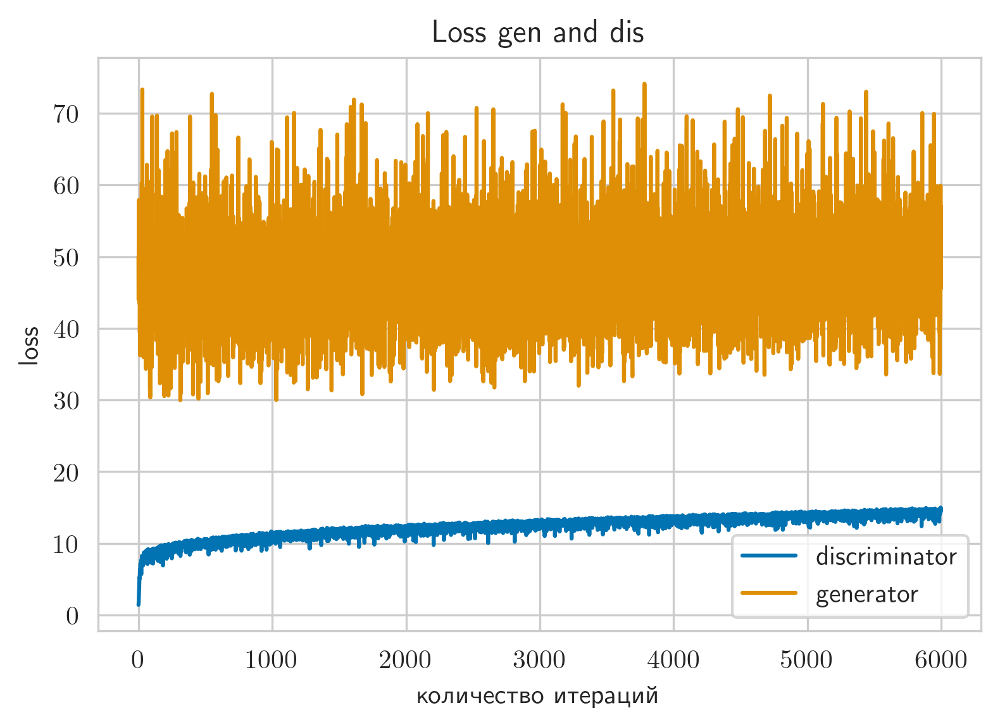

In [15]:
plt.plot(dis_loss_collection, label='discriminator')
plt.plot(gen_loss_collection, label='generator')
plt.title(f'Loss gen and dis')
plt.xlabel('количество итераций')
plt.ylabel('loss')
plt.legend()
plt.show()

In [16]:
images = []
for i, (input_tensor, output_tensor) in enumerate(test_dataloader):
    if i == 15:
        break
    with torch.no_grad():
        generated = generator(input_tensor.to(device)).to("cpu").squeeze(0)
        images.append(
            (
                inverse_transform(input_tensor.to("cpu").squeeze(0)), 
                inverse_transform(output_tensor.to("cpu").squeeze(0)), 
                inverse_transform(generated)
            )
        )

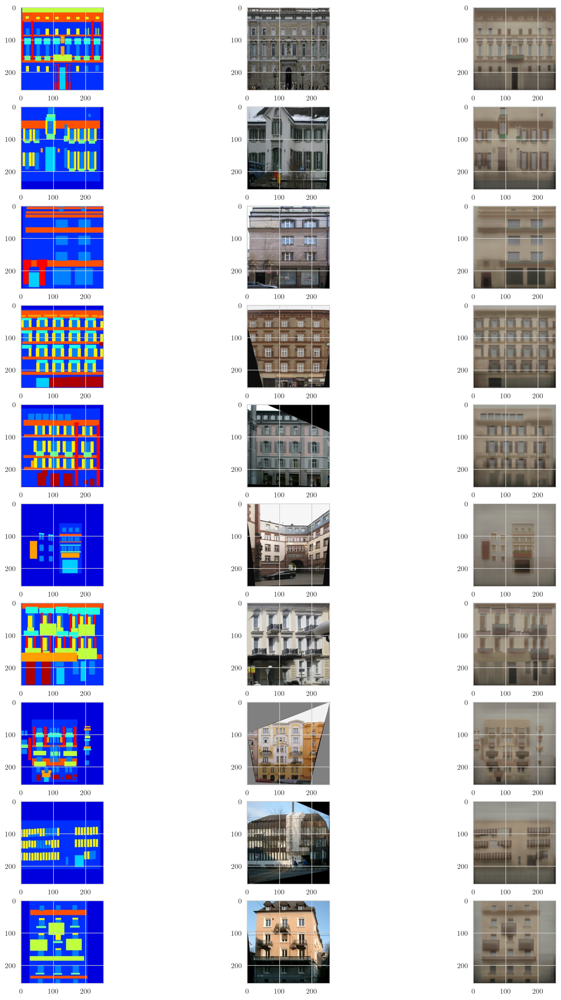

In [17]:
fig, ax = plt.subplots(10, 3)
fig.set_figwidth(16)
fig.set_figheight(25)
for i in range(10):
    ax[i, 0].imshow(np.array(images[i][0]))
    ax[i, 1].imshow(np.array(images[i][1]))
    ax[i, 2].imshow(np.array(images[i][2]))

In [18]:
class ResnetBlock(nn.Module):

    def __init__(self, dim):
        super().__init__()
        self.conv_block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, kernel_size=3, padding=0), 
            nn.InstanceNorm2d(dim), 
            nn.ReLU(True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, kernel_size=3, padding=0),
            nn.InstanceNorm2d(dim)
        )

    def forward(self, x):
        out = x + self.conv_block(x)
        return out

In [19]:
class ResnetGenerator(nn.Module):

    def __init__(self, input_nc, ngf=64, norm_layer=nn.BatchNorm2d, n_blocks=6):

        super().__init__()

        model = [nn.ReflectionPad2d(3),
                 nn.Conv2d(input_nc, ngf, kernel_size=7, padding=0),
                 nn.InstanceNorm2d(ngf),
                 nn.ReLU(True)]

        n_downsampling = 2
        for i in range(n_downsampling):  # add downsampling layers
            mult = 2 ** i
            model += [nn.Conv2d(ngf * mult, ngf * mult * 2, kernel_size=3, stride=2, padding=1),
                      nn.InstanceNorm2d(ngf * mult * 2),
                      nn.ReLU(True)]

        mult = 2 ** n_downsampling
        for i in range(n_blocks):

            model += [ResnetBlock(ngf * mult)]

        for i in range(n_downsampling):
            mult = 2 ** (n_downsampling - i)
            model += [nn.ConvTranspose2d(ngf * mult, int(ngf * mult / 2),
                                         kernel_size=3, stride=2,
                                         padding=1, output_padding=1),
                      nn.InstanceNorm2d(int(ngf * mult / 2)),
                      nn.ReLU(True)]
        model += [nn.ReflectionPad2d(3)]
        model += [nn.Conv2d(ngf, input_nc, kernel_size=7, padding=0)]
        model += [nn.Tanh()]

        self.model = nn.Sequential(*model)

    def forward(self, x):
        return self.model(x)

In [20]:
del generator
del discriminator
del optimizer_discriminator
del optimizer_generator

In [21]:
class FacadeDatasetCycle(Dataset):

    def __init__(self, path, transforms):
        super().__init__()
        self.image_pathes = list(Path(path).rglob("*.jpg"))
        self.transforms = transforms

    def __len__(self):
        return len(self.image_pathes)

    def __getitem__(self, idx):
        path = self.image_pathes[idx]
        image = Image.open(path)
        width = image.width
        sep = width // 2
        image_array = np.array(image)
        mask = image_array[:, sep:]

        path = np.random.choice(self.image_pathes)
        image = Image.open(path)
        image_array = np.array(image)
        facade = image_array[:, :sep]

        mask = self.transforms(mask)
        facade = self.transforms(facade)
        return mask, facade

In [22]:
generator_facade = ResnetGenerator(3)
generator_mask = ResnetGenerator(3)

discriminator_facade = nn.Sequential(
    torchvision.models.resnet18(pretrained=False, num_classes=1, norm_layer=nn.InstanceNorm2d),
    nn.Sigmoid()
)
discriminator_mask = nn.Sequential(
    torchvision.models.resnet18(pretrained=False, num_classes=1, norm_layer=nn.InstanceNorm2d),
    nn.Sigmoid()
)

In [23]:
generator_facade = generator_facade.to(device)
generator_mask = generator_mask.to(device)
discriminator_facade = discriminator_facade.to(device)
discriminator_mask = discriminator_mask.to(device)

In [24]:
train_dataset = FacadeDatasetCycle("facades/train", transform)
test_dataset = FacadeDatasetCycle("facades/test", transform)

In [25]:
train_dataloader = DataLoader(
    train_dataset,
    batch_size=1,
    shuffle=True,
)

test_dataloader = DataLoader(
    test_dataset,
    batch_size=1,
    shuffle=True,
)

In [26]:
EPOCH = 100
LR_GEN = 2e-3
LR_DIS = 2e-3
LAMBDA_CONSTRUCT = 50

In [27]:
optimizer_generator_facade = torch.optim.Adam(generator_facade.parameters(), lr=LR_GEN)
optimizer_generator_mask = torch.optim.Adam(generator_mask.parameters(), lr=LR_GEN)
optimizer_discriminator_facade = torch.optim.Adam(discriminator_facade.parameters(), lr=LR_DIS)
optimizer_discriminator_mask = torch.optim.Adam(discriminator_mask.parameters(), lr=LR_DIS)
dis_loss_collection = []
gen_loss_collection = []

In [28]:
for epoch in range(EPOCH):
    for i, (mask, facade) in enumerate(train_dataloader):

        mask = mask.to(device)
        facade = facade.to(device)
        
        optimizer_generator_facade.zero_grad()
        optimizer_generator_mask.zero_grad()

        facade_gen = generator_facade(mask)
        mask_gen = generator_mask(facade)
        facade_recon = generator_facade(mask_gen)
        mask_recon = generator_mask(facade_gen)

        loss_facade_recon = F.l1_loss(facade_recon, facade)
        loss_mask_recon = F.l1_loss(mask_recon, mask)

        discriminator_facade.requires_grad_(False)
        discriminator_mask.requires_grad_(False)

        facade_false = discriminator_facade(facade_gen)
        mask_false = discriminator_mask(mask_gen)

        valid = torch.ones_like(mask_false).to(device)
        false = torch.zeros_like(mask_false).to(device)

        loss_dis_gen_facade = F.mse_loss(facade_false, valid)
        loss_dis_gen_mask = F.mse_loss(mask_false, valid)

        loss_gen = loss_dis_gen_facade + loss_dis_gen_mask + LAMBDA_CONSTRUCT * (loss_facade_recon + loss_mask_recon)
        loss_gen.backward()

        optimizer_generator_facade.step()
        optimizer_generator_mask.step()

        optimizer_discriminator_facade.zero_grad()
        optimizer_discriminator_mask.zero_grad()
        discriminator_facade.requires_grad_(True)
        discriminator_mask.requires_grad_(True)

        facade_true = discriminator_facade(facade)
        mask_true = discriminator_mask(mask)
        facade_false = discriminator_facade(facade_gen.detach())
        mask_false = discriminator_mask(mask_gen.detach())

        loss_dis_facade_fake = F.mse_loss(facade_false, false)
        loss_dis_facade_true = F.mse_loss(facade_true, valid)
        loss_dis_mask_fake = F.mse_loss(mask_false, false)
        loss_dis_mask_true = F.mse_loss(mask_true, valid)

        loss_dis = loss_dis_facade_fake + loss_dis_facade_true + loss_dis_mask_fake + loss_dis_mask_true
        loss_dis.backward()
        
        gen_loss_collection.append(loss_gen.item())
        dis_loss_collection.append(loss_dis.item())

        optimizer_discriminator_facade.step()
        optimizer_discriminator_mask.step()

        if (i + 1) % 200 == 0:
            print(f"Epoch: {epoch + 1} / {EPOCH}, iter: {i + 1}/{len(train_dataloader)}, loss_gen: {loss_gen.item():.3f}, loss_dis: {loss_dis.item():.3f}")

Epoch: 1 / 100, iter: 200/400, loss_gen: 40.748, loss_dis: 0.336
Epoch: 1 / 100, iter: 400/400, loss_gen: 27.720, loss_dis: 1.007
Epoch: 2 / 100, iter: 200/400, loss_gen: 26.757, loss_dis: 0.274
Epoch: 2 / 100, iter: 400/400, loss_gen: 26.829, loss_dis: 0.007
Epoch: 3 / 100, iter: 200/400, loss_gen: 25.267, loss_dis: 0.397
Epoch: 3 / 100, iter: 400/400, loss_gen: 21.580, loss_dis: 0.000
Epoch: 4 / 100, iter: 200/400, loss_gen: 16.443, loss_dis: 0.001
Epoch: 4 / 100, iter: 400/400, loss_gen: 15.271, loss_dis: 0.000
Epoch: 5 / 100, iter: 200/400, loss_gen: 17.203, loss_dis: 0.001
Epoch: 5 / 100, iter: 400/400, loss_gen: 14.925, loss_dis: 0.004
Epoch: 6 / 100, iter: 200/400, loss_gen: 14.781, loss_dis: 0.997
Epoch: 6 / 100, iter: 400/400, loss_gen: 19.607, loss_dis: 0.013
Epoch: 7 / 100, iter: 200/400, loss_gen: 10.746, loss_dis: 0.000
Epoch: 7 / 100, iter: 400/400, loss_gen: 17.569, loss_dis: 0.000
Epoch: 8 / 100, iter: 200/400, loss_gen: 15.592, loss_dis: 0.987
Epoch: 8 / 100, iter: 400

Epoch: 64 / 100, iter: 200/400, loss_gen: 7.245, loss_dis: 0.000
Epoch: 64 / 100, iter: 400/400, loss_gen: 6.896, loss_dis: 0.000
Epoch: 65 / 100, iter: 200/400, loss_gen: 7.139, loss_dis: 0.000
Epoch: 65 / 100, iter: 400/400, loss_gen: 8.662, loss_dis: 0.000
Epoch: 66 / 100, iter: 200/400, loss_gen: 7.463, loss_dis: 0.000
Epoch: 66 / 100, iter: 400/400, loss_gen: 6.271, loss_dis: 0.000
Epoch: 67 / 100, iter: 200/400, loss_gen: 8.066, loss_dis: 0.000
Epoch: 67 / 100, iter: 400/400, loss_gen: 6.240, loss_dis: 0.000
Epoch: 68 / 100, iter: 200/400, loss_gen: 7.689, loss_dis: 0.000
Epoch: 68 / 100, iter: 400/400, loss_gen: 6.161, loss_dis: 0.000
Epoch: 69 / 100, iter: 200/400, loss_gen: 6.969, loss_dis: 0.000
Epoch: 69 / 100, iter: 400/400, loss_gen: 6.649, loss_dis: 0.000
Epoch: 70 / 100, iter: 200/400, loss_gen: 7.665, loss_dis: 0.000
Epoch: 70 / 100, iter: 400/400, loss_gen: 6.273, loss_dis: 0.000
Epoch: 71 / 100, iter: 200/400, loss_gen: 6.590, loss_dis: 0.000
Epoch: 71 / 100, iter: 40

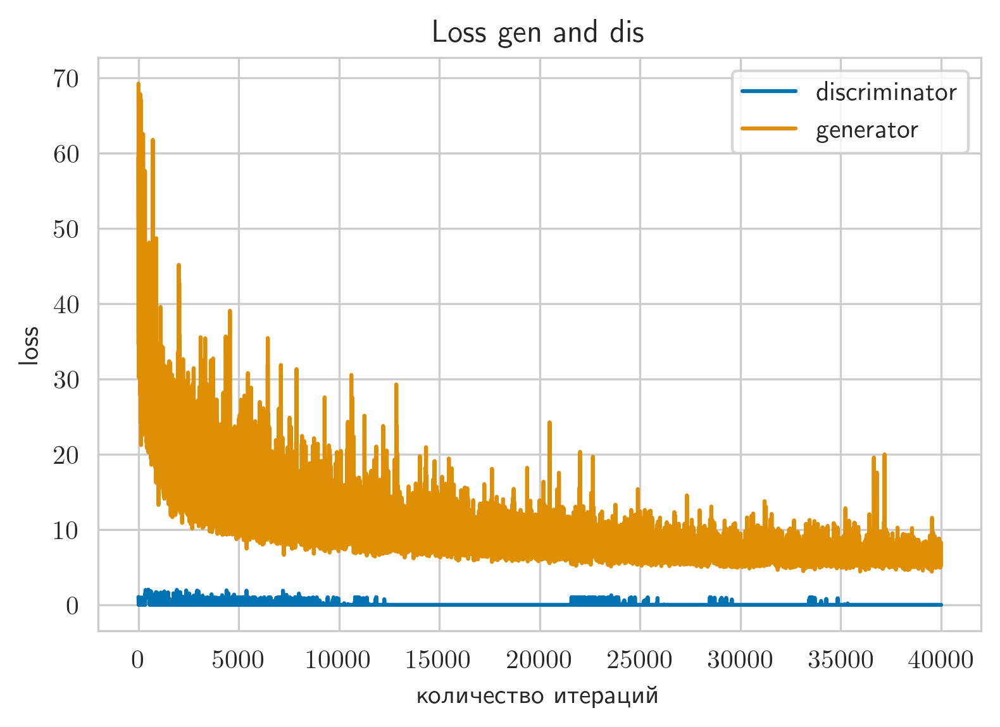

In [29]:
plt.plot(dis_loss_collection, label='discriminator')
plt.plot(gen_loss_collection, label='generator')
plt.title(f'Loss gen and dis')
plt.xlabel('количество итераций')
plt.ylabel('loss')
plt.legend()
plt.show()

In [32]:
images = []
for i, (mask, facade) in enumerate(test_dataloader):
    if i == 15:
        break
    with torch.no_grad():
        generated_facade = generator_facade(mask.to(device)).to("cpu").squeeze(0)
        generated_mask = generator_mask(facade.to(device)).to("cpu").squeeze(0)
        images.append(
            (
                inverse_transform(mask.to("cpu").squeeze(0)), 
                inverse_transform(facade.to("cpu").squeeze(0)), 
                inverse_transform(generated_mask),
                inverse_transform(generated_facade)
            )
        )

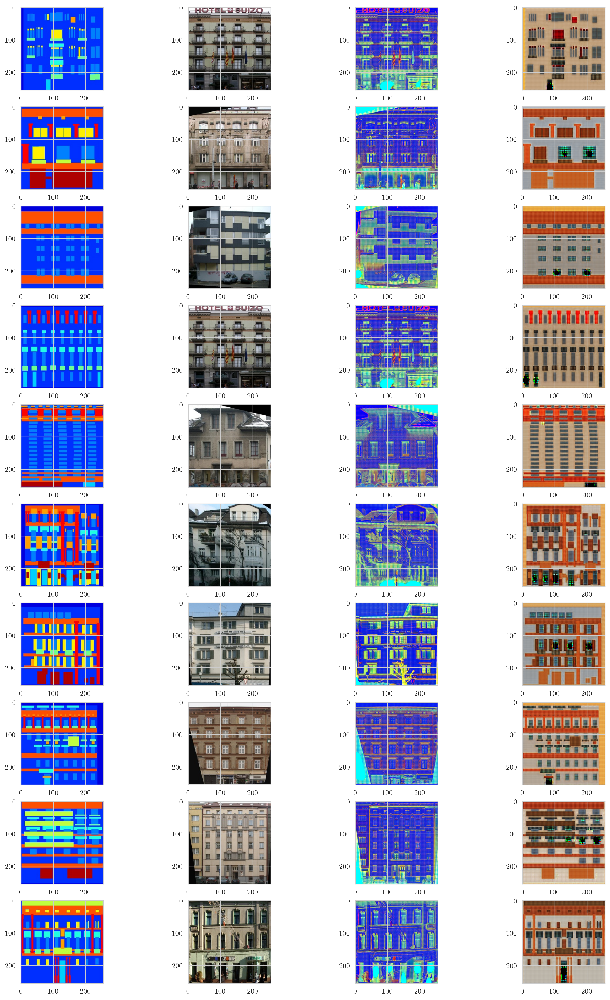

In [33]:
fig, ax = plt.subplots(10, 4)
fig.set_figwidth(16)
fig.set_figheight(25)
for i in range(10):
    ax[i, 0].imshow(np.array(images[i][0]))
    ax[i, 1].imshow(np.array(images[i][1]))
    ax[i, 2].imshow(np.array(images[i][2]))
    ax[i, 3].imshow(np.array(images[i][3]))